In [1]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import requests
import tarfile 
import time

import torch

try:
    from skimage.metrics import peak_signal_noise_ratio as psnr
    from skimage.metrics import structural_similarity as ssim
    print("scikit-image found.")
except ImportError:
    print("scikit-image not found. Installing...")
    !pip install scikit-image -q
    from skimage.metrics import peak_signal_noise_ratio as psnr
    from skimage.metrics import structural_similarity as ssim
    print("scikit-image installed.")

try:
    sr = cv2.dnn_superres.DnnSuperResImpl_create()
    print("OpenCV dnn_superres module found.")
    os.makedirs('sr_models', exist_ok=True)
except AttributeError:
    print("Warning: OpenCV dnn_superres module might not be available in the default cv2 package.")
    print("Standard interpolation will work, but pre-trained OpenCV models might fail.")
    print("Consider installing opencv-contrib-python if needed (might conflict with other libraries).")
except Exception as e:
     print(f"An error occurred initializing dnn_superres: {e}")


print(f"PyTorch version: {torch.__version__}")
print(f"OpenCV version: {cv2.__version__}")

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

print("\nKurulum tamamlandı!")

scikit-image found.
OpenCV dnn_superres module found.
PyTorch version: 2.5.1+cu124
OpenCV version: 4.11.0
Using device: cuda

Kurulum tamamlandı!


Searching for HR images in: /kaggle/input/family-guy-scenes/family guy scenes
Toplam 31 resim bulundu. İlk 31 tanesi işlenecek.

Processing HR image: Image_22.jpg
  - Original HR shape: (2250, 4000, 3)
  - Generated LR shape: (562, 1000, 3)
  - LR image saved to: /kaggle/working/lr_images/Image_22_lr_x4.png

Processing HR image: Image_4.jpg
  - Original HR shape: (1000, 1600, 3)
  - Generated LR shape: (250, 400, 3)
  - LR image saved to: /kaggle/working/lr_images/Image_4_lr_x4.png

Processing HR image: Image_12.jpg
  - Original HR shape: (1308, 736, 3)
  - Generated LR shape: (327, 184, 3)
  - LR image saved to: /kaggle/working/lr_images/Image_12_lr_x4.png

Processing HR image: Image_16.jpg
  - Original HR shape: (720, 1280, 3)
  - Generated LR shape: (180, 320, 3)
  - LR image saved to: /kaggle/working/lr_images/Image_16_lr_x4.png

Processing HR image: Image_2.jpg
  - Original HR shape: (1257, 2400, 3)
  - Generated LR shape: (314, 600, 3)
  - LR image saved to: /kaggle/working/lr_im

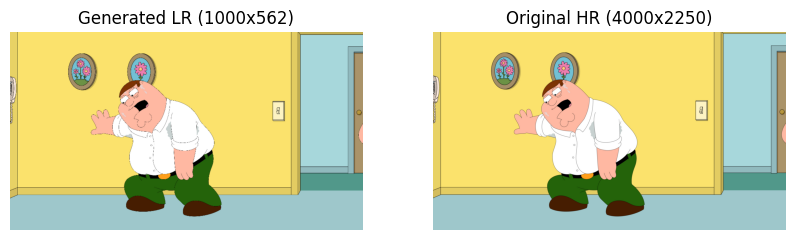

In [2]:
import os
import cv2
import glob 
import numpy as np
import matplotlib.pyplot as plt
hr_image_dir = "/kaggle/input/family-guy-scenes/family guy scenes" 

lr_save_dir = "/kaggle/working/lr_images/"
os.makedirs(lr_save_dir, exist_ok=True) 

scale_factor = 4

num_images_to_process = 31

test_images_sr = []

print(f"Searching for HR images in: {hr_image_dir}")
try:
    hr_image_paths_all = glob.glob(os.path.join(hr_image_dir, '*.[jJ][pP][gG]')) + \
                         glob.glob(os.path.join(hr_image_dir, '*.[pP][nN][gG]')) + \
                         glob.glob(os.path.join(hr_image_dir, '*.[jJ][pP][eE][gG]'))

    if not hr_image_paths_all:
        print(f"HATA: Belirtilen dizinde hiç resim bulunamadı: {hr_image_dir}")
        print("Lütfen yolun doğruluğunu ve resimleri içeren klasöre işaret ettiğini kontrol edin.")
    else:
        print(f"Toplam {len(hr_image_paths_all)} resim bulundu. İlk {num_images_to_process} tanesi işlenecek.")
        hr_image_paths_selected = hr_image_paths_all[:num_images_to_process]

        for hr_path in hr_image_paths_selected:
            base_filename = os.path.basename(hr_path)
            print(f"\nProcessing HR image: {base_filename}")
            hr_img = cv2.imread(hr_path)

            if hr_img is None:
                print(f"  - Uyarı: Resim okunamadı: {hr_path}. Atlanıyor.")
                continue

            hr_height, hr_width = hr_img.shape[:2]
            print(f"  - Original HR shape: {hr_img.shape}")
            if hr_height < scale_factor or hr_width < scale_factor:
                 print(f"  - Uyarı: Resim ({hr_img.shape}) x{scale_factor} küçültmek için çok küçük. Atlanıyor.")
                 continue
            lr_height = hr_height // scale_factor
            lr_width = hr_width // scale_factor

            lr_img = cv2.resize(hr_img, (lr_width, lr_height), interpolation=cv2.INTER_CUBIC)
            print(f"  - Generated LR shape: {lr_img.shape}")

            lr_filename_base = os.path.splitext(base_filename)[0]
            lr_filename = f"{lr_filename_base}_lr_x{scale_factor}.png"
            lr_save_path = os.path.join(lr_save_dir, lr_filename)
            success = cv2.imwrite(lr_save_path, lr_img)
            if success:
                print(f"  - LR image saved to: {lr_save_path}")
                test_images_sr.append({'lr': lr_save_path, 'hr': hr_path})
            else:
                print(f"  - Hata: LR image could not be saved to {lr_save_path}.")


except FileNotFoundError:
    print(f"HATA: Dizin bulunamadı: {hr_image_dir}")
    print("Lütfen veri setinin eklendiğinden ve yolun doğru olduğundan emin olun.")
except Exception as e:
    print(f"Beklenmedik bir hata oluştu: {e}")

print(f"\nTest için {len(test_images_sr)} adet LR/HR resim çifti hazırlandı.")
if test_images_sr:
    print("\nÖrnek çift:")
    print(f"  LR Yolu: {test_images_sr[0]['lr']}")
    print(f"  HR Yolu: {test_images_sr[0]['hr']}")
    
    try:
        img_lr_ex = cv2.imread(test_images_sr[0]['lr'])
        img_hr_ex = cv2.imread(test_images_sr[0]['hr'])
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(cv2.cvtColor(img_lr_ex, cv2.COLOR_BGR2RGB))
        plt.title(f'Generated LR ({img_lr_ex.shape[1]}x{img_lr_ex.shape[0]})')
        plt.axis('off')
        plt.subplot(1, 2, 2)
        plt.imshow(cv2.cvtColor(img_hr_ex, cv2.COLOR_BGR2RGB))
        plt.title(f'Original HR ({img_hr_ex.shape[1]}x{img_hr_ex.shape[0]})')
        plt.axis('off')
        plt.show()
    except Exception as vis_e:
        print(f"Could not visualize example pair: {vis_e}")


Applying Bicubic Upscaling (x4) to 31 LR images...

Processing: Image_22_lr_x4.png
  - Upscaling LR (1000x562) to HR (4000x2250) using Bicubic...
  - Bicubic resize done in 0.0055 seconds.
  - Bicubic result saved to: /kaggle/working/bicubic_results/Image_22_bicubic_x4.png

Processing: Image_4_lr_x4.png
  - Upscaling LR (400x250) to HR (1600x1000) using Bicubic...
  - Bicubic resize done in 0.0015 seconds.
  - Bicubic result saved to: /kaggle/working/bicubic_results/Image_4_bicubic_x4.png

Processing: Image_12_lr_x4.png
  - Upscaling LR (184x327) to HR (736x1308) using Bicubic...
  - Bicubic resize done in 0.0010 seconds.
  - Bicubic result saved to: /kaggle/working/bicubic_results/Image_12_bicubic_x4.png

Processing: Image_16_lr_x4.png
  - Upscaling LR (320x180) to HR (1280x720) using Bicubic...
  - Bicubic resize done in 0.0009 seconds.
  - Bicubic result saved to: /kaggle/working/bicubic_results/Image_16_bicubic_x4.png

Processing: Image_2_lr_x4.png
  - Upscaling LR (600x314) to HR

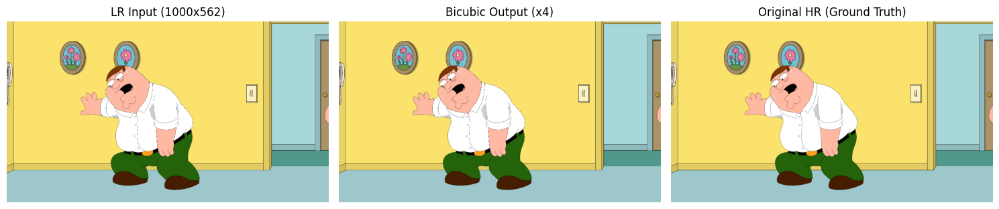

In [3]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

bicubic_save_dir = "/kaggle/working/bicubic_results/"
os.makedirs(bicubic_save_dir, exist_ok=True)

try:
    if 'test_images_sr' not in locals() or not test_images_sr:
        raise NameError("test_images_sr list not found or is empty. Please run Step B.2 first.")
    if 'scale_factor' not in locals():
        scale_factor = 4
        print(f"Warning: scale_factor not found, assuming default: {scale_factor}")

    print(f"\nApplying Bicubic Upscaling (x{scale_factor}) to {len(test_images_sr)} LR images...")

    for i, pair in enumerate(test_images_sr):
        lr_path = pair['lr']
        hr_path = pair['hr']
        base_filename = os.path.basename(lr_path)
        print(f"\nProcessing: {base_filename}")

        lr_img = cv2.imread(lr_path)
        hr_img = cv2.imread(hr_path)

        if lr_img is None:
            print(f"  - Error: Could not read LR image: {lr_path}. Skipping.")
            continue
        if hr_img is None:
            print(f"  - Error: Could not read HR image: {hr_path}. Skipping LR image {lr_path}.")
            test_images_sr[i]['bicubic'] = None 
            continue

        target_height, target_width = hr_img.shape[:2]
        print(f"  - Upscaling LR ({lr_img.shape[1]}x{lr_img.shape[0]}) to HR ({target_width}x{target_height}) using Bicubic...")

        start_time_bicubic = time.time()
        bicubic_img = cv2.resize(lr_img, (target_width, target_height), interpolation=cv2.INTER_CUBIC)
        end_time_bicubic = time.time()
        print(f"  - Bicubic resize done in {end_time_bicubic - start_time_bicubic:.4f} seconds.")

        bicubic_filename = base_filename.replace('_lr_', '_bicubic_') 
        bicubic_save_path = os.path.join(bicubic_save_dir, bicubic_filename)
        success = cv2.imwrite(bicubic_save_path, bicubic_img)

        if success:
            print(f"  - Bicubic result saved to: {bicubic_save_path}")
            test_images_sr[i]['bicubic'] = bicubic_save_path
        else:
            print(f"  - Error: Bicubic result could not be saved to {bicubic_save_path}.")
            test_images_sr[i]['bicubic'] = None

    print(f"\nFinished Bicubic Upscaling for all images.")

    if test_images_sr and test_images_sr[0].get('bicubic'):
        print("\nVisualizing example for the first image:")
        lr_ex = cv2.imread(test_images_sr[0]['lr'])
        hr_ex = cv2.imread(test_images_sr[0]['hr'])
        bicubic_ex = cv2.imread(test_images_sr[0]['bicubic'])

        if lr_ex is not None and hr_ex is not None and bicubic_ex is not None:
             plt.figure(figsize=(15, 5))
             plt.subplot(1, 3, 1)
             plt.imshow(cv2.cvtColor(lr_ex, cv2.COLOR_BGR2RGB))
             plt.title(f'LR Input ({lr_ex.shape[1]}x{lr_ex.shape[0]})')
             plt.axis('off')

             plt.subplot(1, 3, 2)
             plt.imshow(cv2.cvtColor(bicubic_ex, cv2.COLOR_BGR2RGB))
             plt.title(f'Bicubic Output (x{scale_factor})')
             plt.axis('off')

             plt.subplot(1, 3, 3)
             plt.imshow(cv2.cvtColor(hr_ex, cv2.COLOR_BGR2RGB))
             plt.title(f'Original HR (Ground Truth)')
             plt.axis('off')

             plt.tight_layout()
             plt.show()
        else:
             print("Could not load images for visualization.")

except NameError as e:
    print(f"ERROR: A required variable (like test_images_sr or scale_factor) is not defined: {e}")
    print("Please ensure Step B.2 was run successfully.")
except Exception as e:
    print(f"An unexpected error occurred: {e}")

2025-04-28 11:09:06.012326: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1745838546.199751      19 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1745838546.254158      19 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


transformers library found.

Initializing Super Resolution pipeline with model: caidas/swin2SR-classical-sr-x4-64


config.json:   0%|          | 0.00/772 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/49.1M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/152 [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.
Device set to use cuda:0


Pipeline initialized successfully.

Applying SR Pipeline (x4) to 31 LR images...

Processing: Image_22_lr_x4.png
  - Input LR size (PIL): (1000, 562)
  - HF Pipeline inference done in 9.1837 seconds.
  - Output SR size (PIL): (4032, 2272)
  - HF Pipeline result saved to: /kaggle/working/hf_pipeline_sr_results/Image_22_hf_sr_x4.png

Processing: Image_4_lr_x4.png
  - Input LR size (PIL): (400, 250)
  - HF Pipeline inference done in 1.4557 seconds.
  - Output SR size (PIL): (1632, 1024)
  - HF Pipeline result saved to: /kaggle/working/hf_pipeline_sr_results/Image_4_hf_sr_x4.png

Processing: Image_12_lr_x4.png
  - Input LR size (PIL): (184, 327)
  - HF Pipeline inference done in 0.7796 seconds.
  - Output SR size (PIL): (768, 1312)
  - HF Pipeline result saved to: /kaggle/working/hf_pipeline_sr_results/Image_12_hf_sr_x4.png

Processing: Image_16_lr_x4.png
  - Input LR size (PIL): (320, 180)
  - HF Pipeline inference done in 0.7235 seconds.
  - Output SR size (PIL): (1312, 736)
  - HF Pipel

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


  - HF Pipeline inference done in 0.7395 seconds.
  - Output SR size (PIL): (736, 1312)
  - HF Pipeline result saved to: /kaggle/working/hf_pipeline_sr_results/Image_27_hf_sr_x4.png

Processing: Image_11_lr_x4.png
  - Input LR size (PIL): (162, 288)
  - HF Pipeline inference done in 0.5923 seconds.
  - Output SR size (PIL): (672, 1184)
  - HF Pipeline result saved to: /kaggle/working/hf_pipeline_sr_results/Image_11_hf_sr_x4.png

Processing: Image_26_lr_x4.png
  - Input LR size (PIL): (184, 327)
  - HF Pipeline inference done in 0.7743 seconds.
  - Output SR size (PIL): (768, 1312)
  - HF Pipeline result saved to: /kaggle/working/hf_pipeline_sr_results/Image_26_hf_sr_x4.png

Processing: Image_28_lr_x4.png
  - Input LR size (PIL): (157, 88)
  - HF Pipeline inference done in 0.1835 seconds.
  - Output SR size (PIL): (640, 384)
  - HF Pipeline result saved to: /kaggle/working/hf_pipeline_sr_results/Image_28_hf_sr_x4.png

Processing: Image_14_lr_x4.png
  - Input LR size (PIL): (270, 480)
  

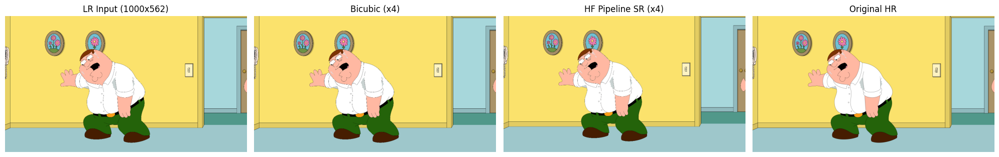

In [4]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import time
from PIL import Image 
import torch

try:
    from transformers import pipeline
    print("transformers library found.")
except ImportError:
    print("transformers library not found. Installing...")
    !pip install transformers accelerate -q
    from transformers import pipeline
    print("transformers and accelerate installed.")

hf_sr_save_dir = "/kaggle/working/hf_pipeline_sr_results/"
os.makedirs(hf_sr_save_dir, exist_ok=True)

model_id = 'caidas/swin2SR-classical-sr-x4-64'
scale_factor = 4

device_pipeline = 0 if torch.cuda.is_available() else -1
pipeline_loaded = False
sr_pipeline = None

try:
    print(f"\nInitializing Super Resolution pipeline with model: {model_id}")
    sr_pipeline = pipeline('image-to-image', model=model_id, device=device_pipeline)
    print("Pipeline initialized successfully.")
    pipeline_loaded = True
except Exception as e:
    print(f"Error initializing Hugging Face pipeline: {e}")
    print("Please check the model ID and your internet connection.")

if pipeline_loaded:
    if 'test_images_sr' not in locals() or not test_images_sr:
        print("ERROR: test_images_sr list not found or is empty. Please run previous steps.")
    else:
        print(f"\nApplying SR Pipeline (x{scale_factor}) to {len(test_images_sr)} LR images...")
        for i, pair in enumerate(test_images_sr):
            lr_path = pair['lr']
            if 'hr' not in pair or pair.get('hr') is None or pair.get('bicubic') is None:
                 print(f"\nSkipping {os.path.basename(lr_path)} due to missing HR or Bicubic result.")
                 test_images_sr[i]['hf_sr'] = None
                 continue

            base_filename = os.path.basename(lr_path)
            print(f"\nProcessing: {base_filename}")

            try:
                lr_image_pil = Image.open(lr_path).convert('RGB')
                print(f"  - Input LR size (PIL): {lr_image_pil.size}")

                start_time_hf = time.time()
                sr_result_image = sr_pipeline(lr_image_pil) 
                end_time_hf = time.time()
                print(f"  - HF Pipeline inference done in {end_time_hf - start_time_hf:.4f} seconds.")
                print(f"  - Output SR size (PIL): {sr_result_image.size}")

                sr_filename_base = os.path.splitext(base_filename.replace(f'_lr_x{scale_factor}',''))[0]
                sr_filename = f"{sr_filename_base}_hf_sr_x{scale_factor}.png"
                sr_save_path = os.path.join(hf_sr_save_dir, sr_filename)
                sr_result_image.save(sr_save_path)
                print(f"  - HF Pipeline result saved to: {sr_save_path}")

                test_images_sr[i]['hf_sr'] = sr_save_path

            except Exception as e:
                print(f"  - An error occurred during HF Pipeline processing for {base_filename}: {e}")
                test_images_sr[i]['hf_sr'] = None

        print(f"\nFinished HF Pipeline Upscaling for all images.")

        if test_images_sr and test_images_sr[0].get('hf_sr'):
            print("\nVisualizing example for the first image:")
            idx_to_show = 0
            try: 
                lr_ex = cv2.imread(test_images_sr[idx_to_show]['lr'])
                hr_ex = cv2.imread(test_images_sr[idx_to_show]['hr'])
                bicubic_ex = cv2.imread(test_images_sr[idx_to_show]['bicubic'])
                hf_sr_ex_pil = Image.open(test_images_sr[idx_to_show]['hf_sr'])
                hf_sr_ex = cv2.cvtColor(np.array(hf_sr_ex_pil), cv2.COLOR_RGB2BGR)

                if all(img is not None for img in [lr_ex, hr_ex, bicubic_ex, hf_sr_ex]):
                     plt.figure(figsize=(20, 5))
                     plt.subplot(1, 4, 1)
                     plt.imshow(cv2.cvtColor(lr_ex, cv2.COLOR_BGR2RGB)); plt.title(f'LR Input ({lr_ex.shape[1]}x{lr_ex.shape[0]})'); plt.axis('off')
                     plt.subplot(1, 4, 2)
                     plt.imshow(cv2.cvtColor(bicubic_ex, cv2.COLOR_BGR2RGB)); plt.title(f'Bicubic (x{scale_factor})'); plt.axis('off')
                     plt.subplot(1, 4, 3)
                     plt.imshow(cv2.cvtColor(hf_sr_ex, cv2.COLOR_BGR2RGB)); plt.title(f'HF Pipeline SR (x{scale_factor})'); plt.axis('off') 
                     plt.subplot(1, 4, 4)
                     plt.imshow(cv2.cvtColor(hr_ex, cv2.COLOR_BGR2RGB)); plt.title(f'Original HR'); plt.axis('off')
                     plt.tight_layout(); plt.show()
                else:
                     print("Could not load all images for visualization.")
            except Exception as viz_e:
                print(f"Error during visualization: {viz_e}")
else:
     print("\nHugging Face Pipeline could not be initialized. Skipping SR processing.")


--- Comparing SR Results ---

Comparing results for: Image_22_lr_x4.png
  - Bilgi: HF_SR çıktısı (2272x4032) HR hedefi (2250x4000) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (2250, 4000, 3), Bicubic: (2250, 4000, 3), HF_SR: (2250, 4000, 3)
  - Bicubic: PSNR=26.38 dB, SSIM=0.9629
  - HF SR  : PSNR=23.77 dB, SSIM=0.9499


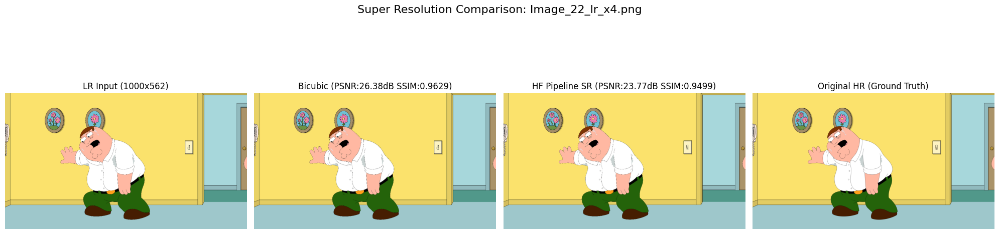


Comparing results for: Image_4_lr_x4.png
  - Bilgi: HF_SR çıktısı (1024x1632) HR hedefi (1000x1600) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1000, 1600, 3), Bicubic: (1000, 1600, 3), HF_SR: (1000, 1600, 3)
  - Bicubic: PSNR=20.83 dB, SSIM=0.8011
  - HF SR  : PSNR=17.83 dB, SSIM=0.7662


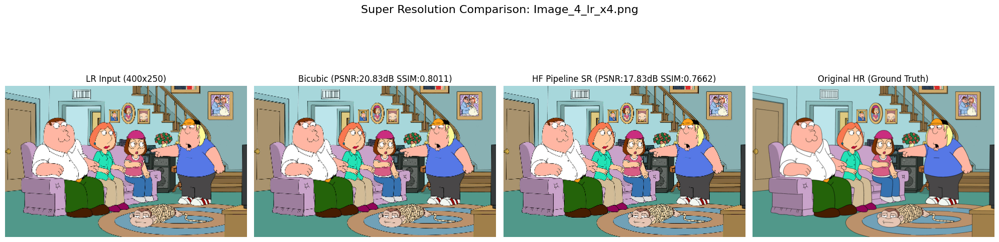


Comparing results for: Image_12_lr_x4.png
  - Bilgi: HF_SR çıktısı (1312x768) HR hedefi (1308x736) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1308, 736, 3), Bicubic: (1308, 736, 3), HF_SR: (1308, 736, 3)
  - Bicubic: PSNR=31.79 dB, SSIM=0.9321
  - HF SR  : PSNR=24.19 dB, SSIM=0.8634


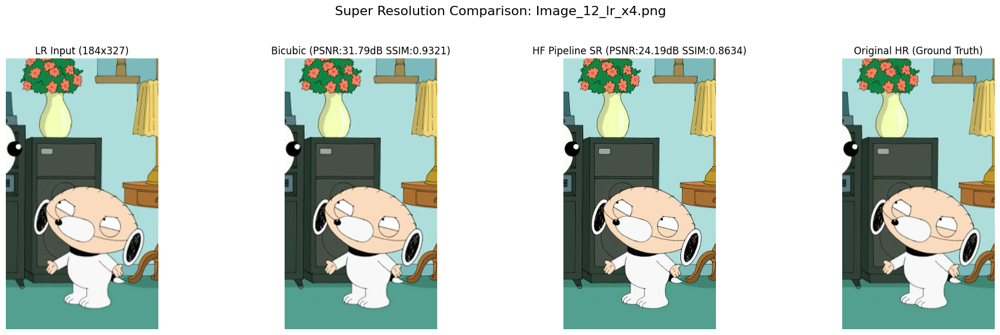


Comparing results for: Image_16_lr_x4.png
  - Bilgi: HF_SR çıktısı (736x1312) HR hedefi (720x1280) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (720, 1280, 3), Bicubic: (720, 1280, 3), HF_SR: (720, 1280, 3)
  - Bicubic: PSNR=27.73 dB, SSIM=0.9450
  - HF SR  : PSNR=24.80 dB, SSIM=0.9065


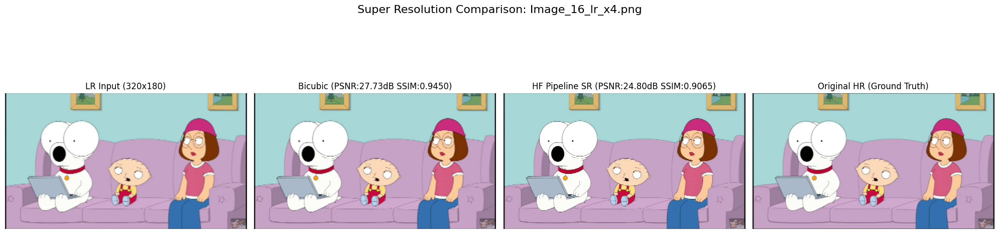


Comparing results for: Image_2_lr_x4.png
  - Bilgi: HF_SR çıktısı (1280x2432) HR hedefi (1257x2400) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1257, 2400, 3), Bicubic: (1257, 2400, 3), HF_SR: (1257, 2400, 3)
  - Bicubic: PSNR=22.65 dB, SSIM=0.8643
  - HF SR  : PSNR=19.91 dB, SSIM=0.8367


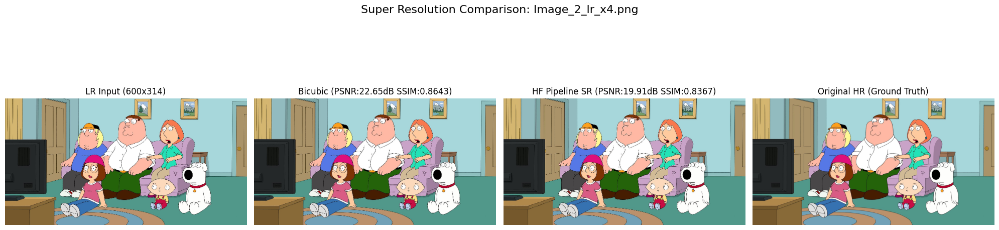


Comparing results for: Image_7_lr_x4.png
  - Bilgi: HF_SR çıktısı (1088x1952) HR hedefi (1080x1920) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1080, 1920, 3), Bicubic: (1080, 1920, 3), HF_SR: (1080, 1920, 3)
  - Bicubic: PSNR=26.79 dB, SSIM=0.8807
  - HF SR  : PSNR=23.03 dB, SSIM=0.8375


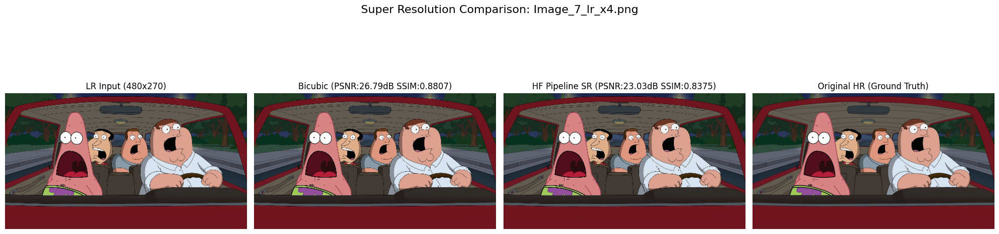


Comparing results for: Image_5_lr_x4.png
  - Bilgi: HF_SR çıktısı (544x736) HR hedefi (540x720) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (540, 720, 3), Bicubic: (540, 720, 3), HF_SR: (540, 720, 3)
  - Bicubic: PSNR=27.36 dB, SSIM=0.8206
  - HF SR  : PSNR=23.41 dB, SSIM=0.7648


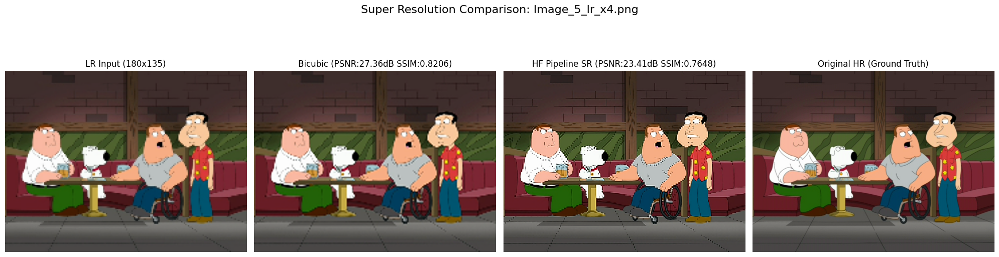


Comparing results for: Image_18_lr_x4.png
  - Bilgi: HF_SR çıktısı (1312x768) HR hedefi (1308x736) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1308, 736, 3), Bicubic: (1308, 736, 3), HF_SR: (1308, 736, 3)
  - Bicubic: PSNR=26.61 dB, SSIM=0.9198
  - HF SR  : PSNR=22.57 dB, SSIM=0.8826


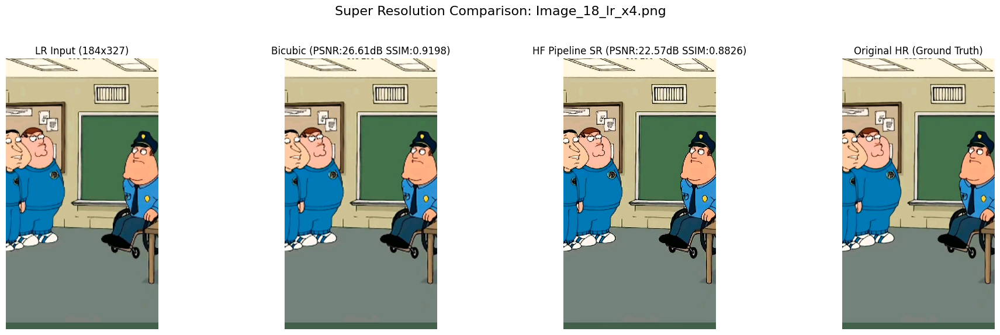


Comparing results for: Image_19_lr_x4.png
  - Bilgi: HF_SR çıktısı (1184x2080) HR hedefi (1152x2048) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1152, 2048, 3), Bicubic: (1152, 2048, 3), HF_SR: (1152, 2048, 3)
  - Bicubic: PSNR=22.83 dB, SSIM=0.8623
  - HF SR  : PSNR=20.39 dB, SSIM=0.8424


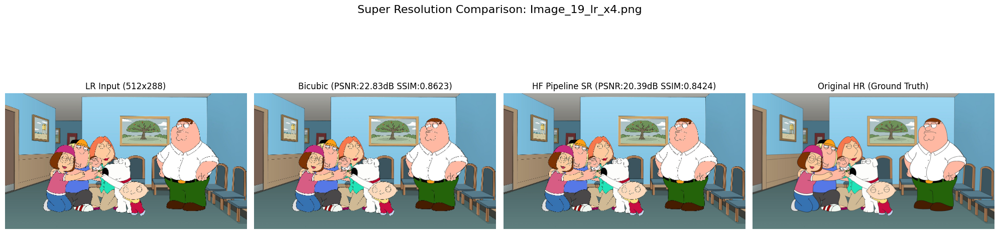


Comparing results for: Image_27_lr_x4.png
  - Bilgi: HF_SR çıktısı (1312x736) HR hedefi (1280x720) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1280, 720, 3), Bicubic: (1280, 720, 3), HF_SR: (1280, 720, 3)
  - Bicubic: PSNR=31.06 dB, SSIM=0.9615
  - HF SR  : PSNR=26.60 dB, SSIM=0.9284


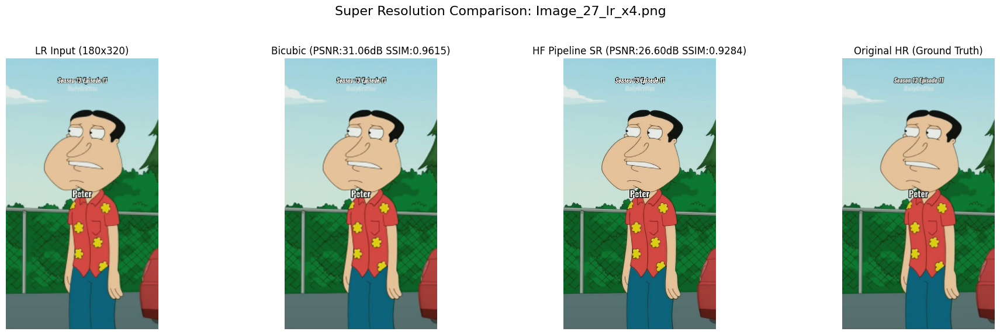


Comparing results for: Image_11_lr_x4.png
  - Bilgi: HF_SR çıktısı (1184x672) HR hedefi (1152x648) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1152, 648, 3), Bicubic: (1152, 648, 3), HF_SR: (1152, 648, 3)
  - Bicubic: PSNR=23.82 dB, SSIM=0.9174
  - HF SR  : PSNR=21.26 dB, SSIM=0.8888


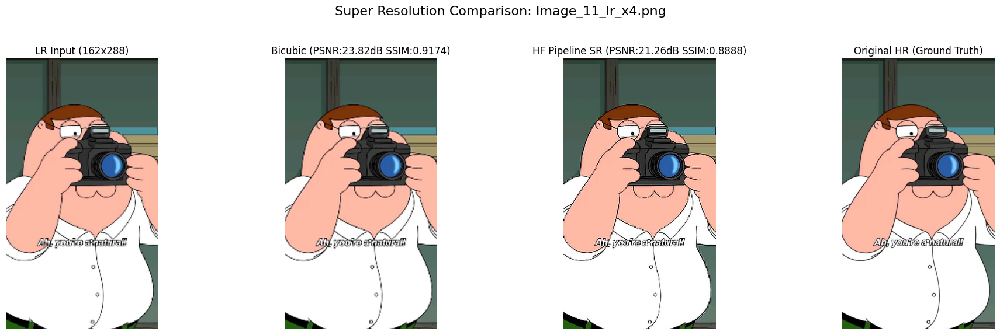


Comparing results for: Image_26_lr_x4.png
  - Bilgi: HF_SR çıktısı (1312x768) HR hedefi (1308x736) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1308, 736, 3), Bicubic: (1308, 736, 3), HF_SR: (1308, 736, 3)
  - Bicubic: PSNR=28.15 dB, SSIM=0.9230
  - HF SR  : PSNR=24.28 dB, SSIM=0.8669


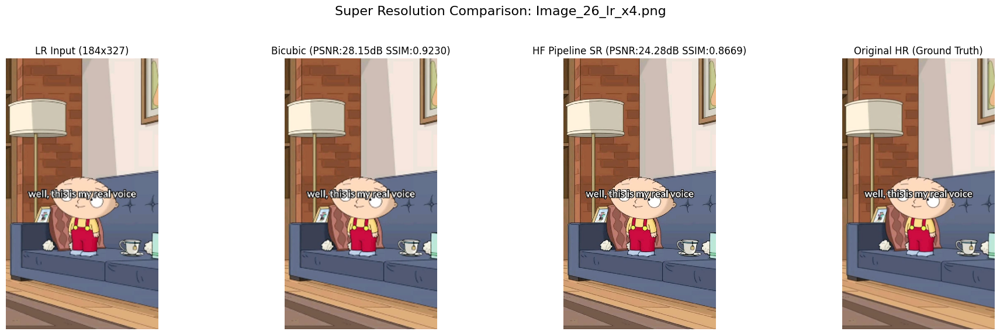


Comparing results for: Image_28_lr_x4.png
  - Bilgi: HF_SR çıktısı (384x640) HR hedefi (354x630) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (354, 630, 3), Bicubic: (354, 630, 3), HF_SR: (354, 630, 3)
  - Bicubic: PSNR=21.25 dB, SSIM=0.7494
  - HF SR  : PSNR=16.43 dB, SSIM=0.6597


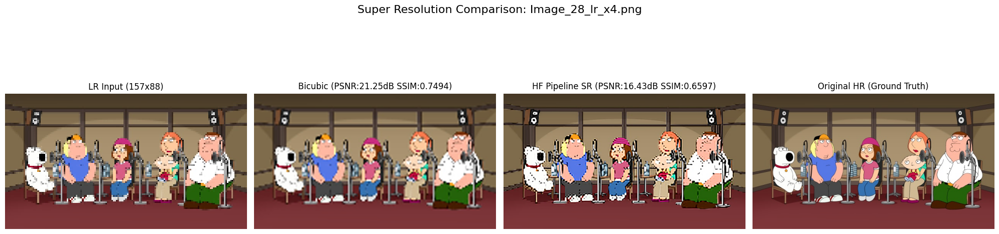


Comparing results for: Image_14_lr_x4.png
  - Bilgi: HF_SR çıktısı (1952x1088) HR hedefi (1920x1080) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1920, 1080, 3), Bicubic: (1920, 1080, 3), HF_SR: (1920, 1080, 3)
  - Bicubic: PSNR=32.03 dB, SSIM=0.9636
  - HF SR  : PSNR=27.19 dB, SSIM=0.9362


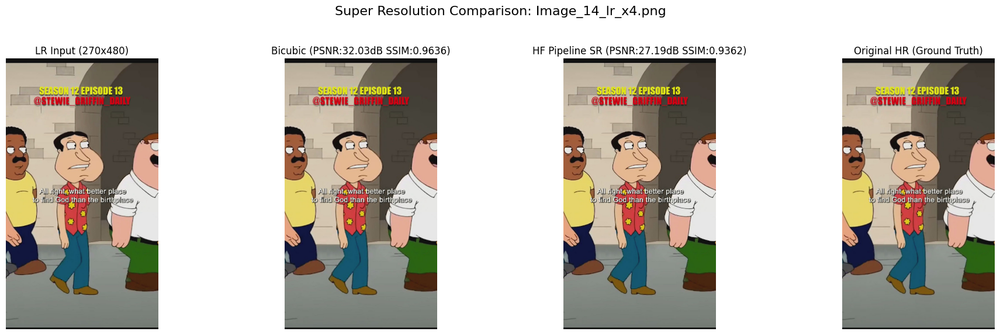


Comparing results for: Image_10_lr_x4.png
  - Bilgi: HF_SR çıktısı (1312x768) HR hedefi (1308x736) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1308, 736, 3), Bicubic: (1308, 736, 3), HF_SR: (1308, 736, 3)
  - Bicubic: PSNR=29.21 dB, SSIM=0.9389
  - HF SR  : PSNR=24.64 dB, SSIM=0.9073


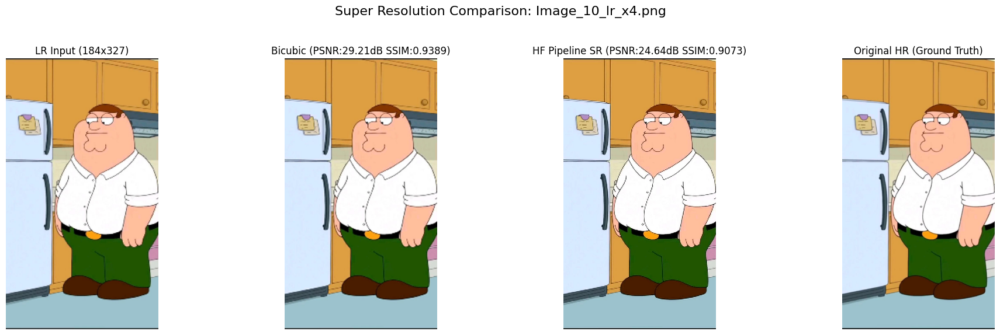


Comparing results for: Image_30_lr_x4.png
  - Bilgi: HF_SR çıktısı (736x1312) HR hedefi (720x1280) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (720, 1280, 3), Bicubic: (720, 1280, 3), HF_SR: (720, 1280, 3)
  - Bicubic: PSNR=24.77 dB, SSIM=0.8329
  - HF SR  : PSNR=21.15 dB, SSIM=0.8048


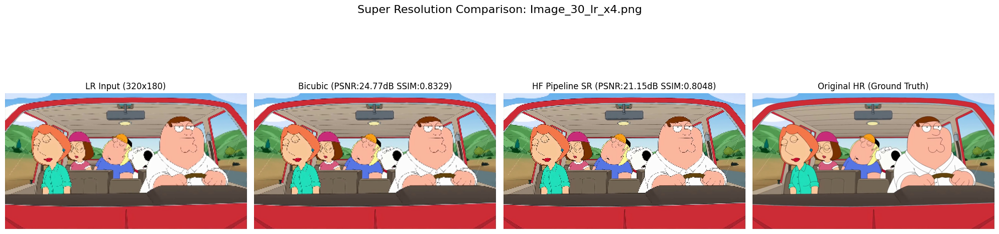


Comparing results for: Image_23_lr_x4.png
  - Bilgi: HF_SR çıktısı (736x1312) HR hedefi (720x1280) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (720, 1280, 3), Bicubic: (720, 1280, 3), HF_SR: (720, 1280, 3)
  - Bicubic: PSNR=27.48 dB, SSIM=0.9054
  - HF SR  : PSNR=23.35 dB, SSIM=0.8618


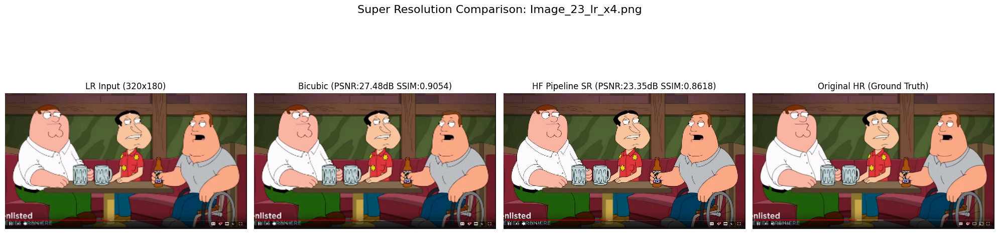


Comparing results for: Image_21_lr_x4.png
  - Bilgi: HF_SR çıktısı (736x1312) HR hedefi (720x1280) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (720, 1280, 3), Bicubic: (720, 1280, 3), HF_SR: (720, 1280, 3)
  - Bicubic: PSNR=29.73 dB, SSIM=0.9219
  - HF SR  : PSNR=24.97 dB, SSIM=0.8839


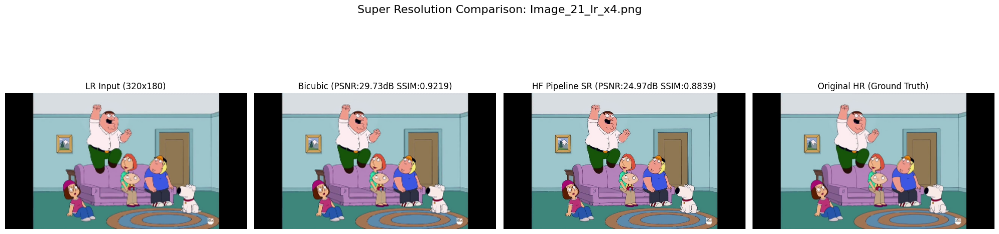


Comparing results for: Image_25_lr_x4.png
  - Bilgi: HF_SR çıktısı (1312x768) HR hedefi (1308x736) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1308, 736, 3), Bicubic: (1308, 736, 3), HF_SR: (1308, 736, 3)
  - Bicubic: PSNR=30.40 dB, SSIM=0.8976
  - HF SR  : PSNR=26.10 dB, SSIM=0.8415


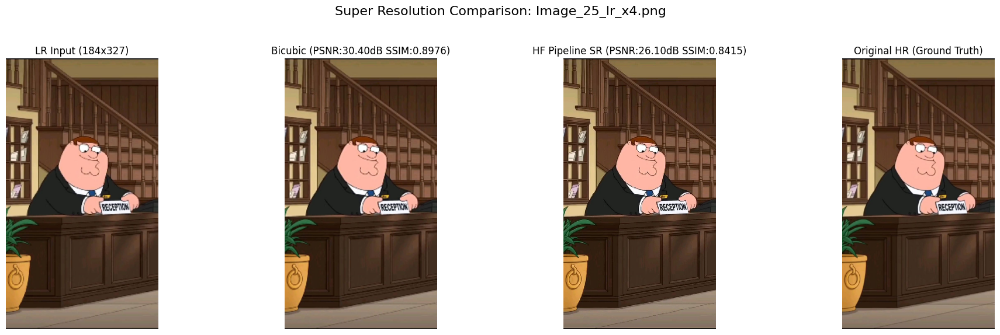


Comparing results for: Image_17_lr_x4.png
  - Bilgi: HF_SR çıktısı (1312x768) HR hedefi (1308x736) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1308, 736, 3), Bicubic: (1308, 736, 3), HF_SR: (1308, 736, 3)
  - Bicubic: PSNR=34.77 dB, SSIM=0.9693
  - HF SR  : PSNR=27.80 dB, SSIM=0.9396


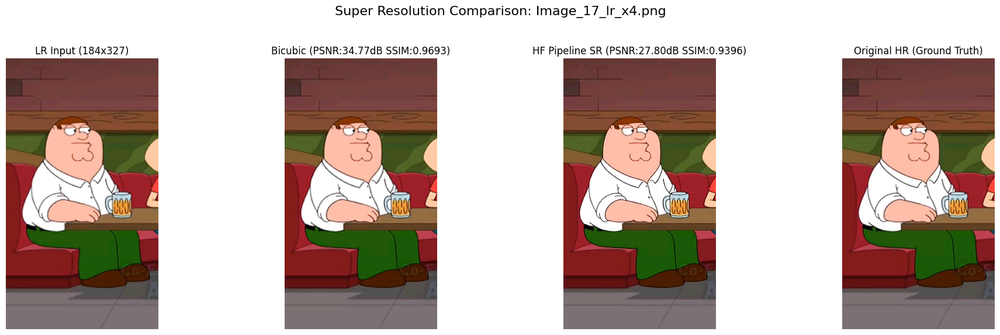


Comparing results for: Image_15_lr_x4.png
  - Bilgi: HF_SR çıktısı (736x1312) HR hedefi (720x1280) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (720, 1280, 3), Bicubic: (720, 1280, 3), HF_SR: (720, 1280, 3)
  - Bicubic: PSNR=26.11 dB, SSIM=0.8857
  - HF SR  : PSNR=22.30 dB, SSIM=0.8622


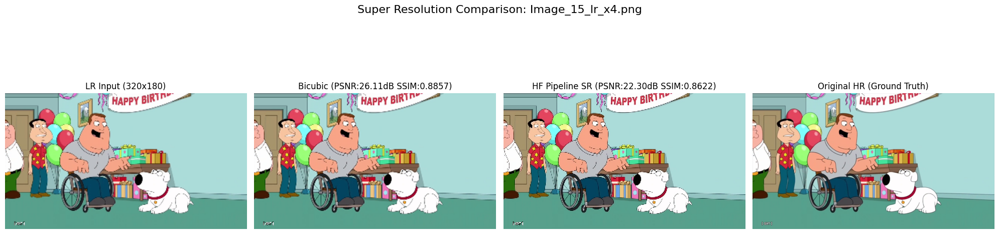


Comparing results for: Image_1_lr_x4.png
  - Bilgi: HF_SR çıktısı (1312x768) HR hedefi (1308x736) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1308, 736, 3), Bicubic: (1308, 736, 3), HF_SR: (1308, 736, 3)
  - Bicubic: PSNR=29.44 dB, SSIM=0.9387
  - HF SR  : PSNR=25.27 dB, SSIM=0.8874


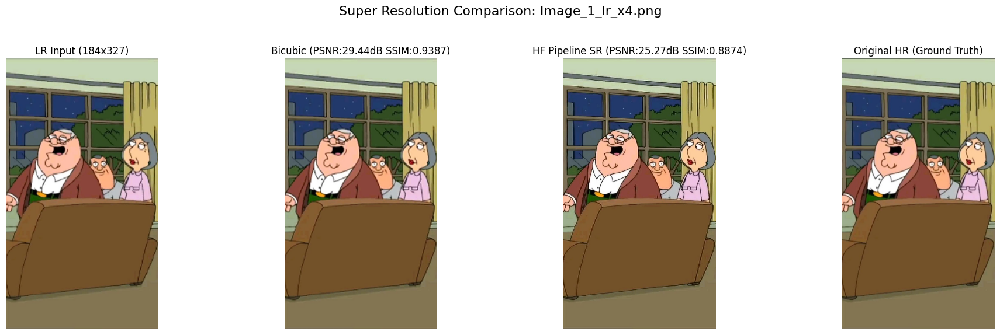


Comparing results for: Image_13_lr_x4.png
  - Bilgi: HF_SR çıktısı (1312x768) HR hedefi (1308x736) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1308, 736, 3), Bicubic: (1308, 736, 3), HF_SR: (1308, 736, 3)
  - Bicubic: PSNR=28.77 dB, SSIM=0.9279
  - HF SR  : PSNR=24.34 dB, SSIM=0.8837


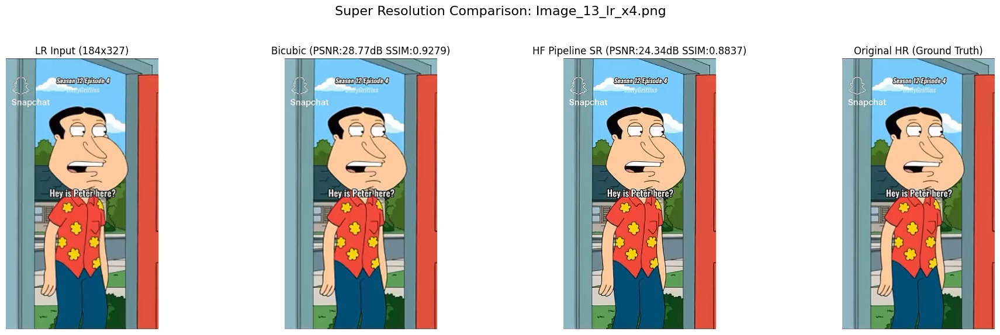


Comparing results for: Image_8_lr_x4.png
  - Bilgi: HF_SR çıktısı (1088x1952) HR hedefi (1080x1920) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1080, 1920, 3), Bicubic: (1080, 1920, 3), HF_SR: (1080, 1920, 3)
  - Bicubic: PSNR=24.30 dB, SSIM=0.8674
  - HF SR  : PSNR=21.21 dB, SSIM=0.8339


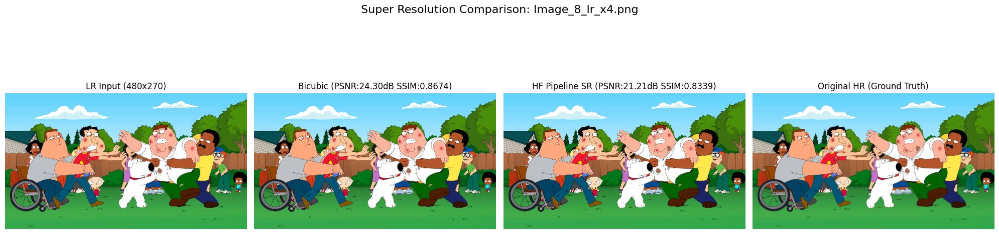


Comparing results for: Image_3_lr_x4.png
  - Bilgi: HF_SR çıktısı (928x1632) HR hedefi (902x1600) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (902, 1600, 3), Bicubic: (902, 1600, 3), HF_SR: (902, 1600, 3)
  - Bicubic: PSNR=29.08 dB, SSIM=0.9089
  - HF SR  : PSNR=22.89 dB, SSIM=0.8493


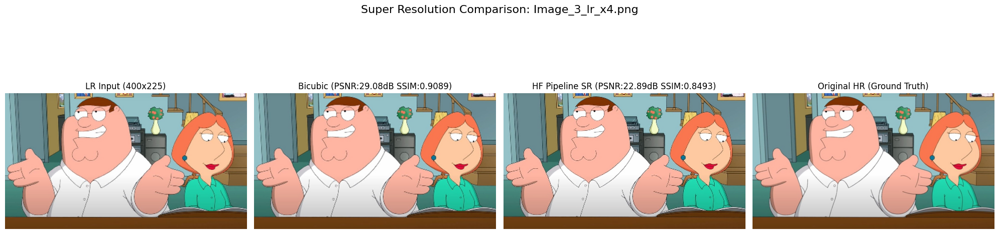


Comparing results for: Image_20_lr_x4.png
  - Bilgi: HF_SR çıktısı (1312x736) HR hedefi (1280x720) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1280, 720, 3), Bicubic: (1280, 720, 3), HF_SR: (1280, 720, 3)
  - Bicubic: PSNR=42.54 dB, SSIM=0.9855
  - HF SR  : PSNR=39.70 dB, SSIM=0.9811


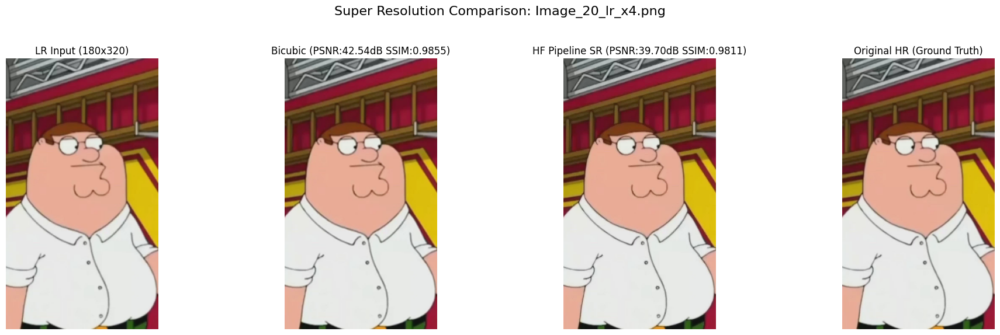


Comparing results for: Image_24_lr_x4.png
  - Bilgi: HF_SR çıktısı (1312x768) HR hedefi (1308x736) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (1308, 736, 3), Bicubic: (1308, 736, 3), HF_SR: (1308, 736, 3)
  - Bicubic: PSNR=28.65 dB, SSIM=0.9229
  - HF SR  : PSNR=24.12 dB, SSIM=0.8761


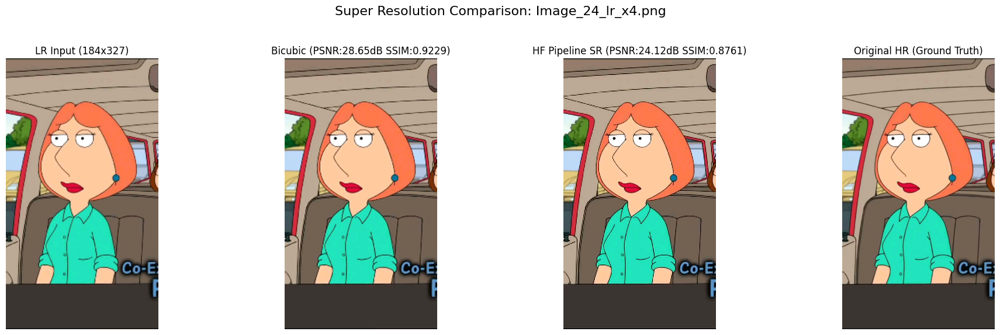


Comparing results for: Image_29_lr_x4.png
  - Shapes after potential crop -- HR: (900, 900, 3), Bicubic: (438, 780, 3), HF_SR: (448, 800, 3)
  - UYARI: Boyutlar kırpmadan sonra bile eşleşmiyor! Metrikler atlanıyor.


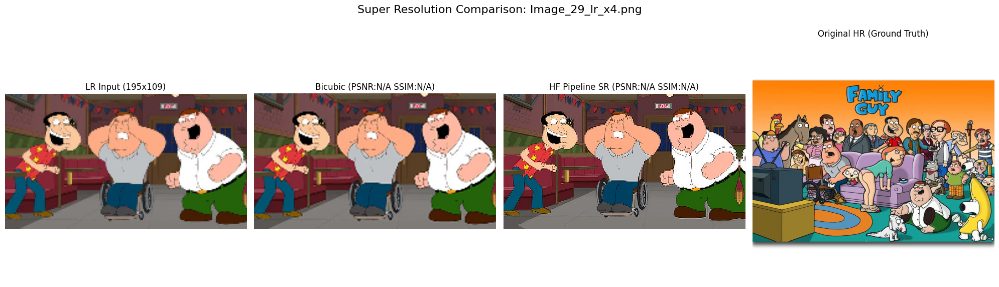


Comparing results for: Image_6_lr_x4.png
  - Bilgi: HF_SR çıktısı (448x800) HR hedefi (438x780) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (438, 780, 3), Bicubic: (438, 780, 3), HF_SR: (438, 780, 3)
  - Bicubic: PSNR=22.72 dB, SSIM=0.7561
  - HF SR  : PSNR=18.53 dB, SSIM=0.6861


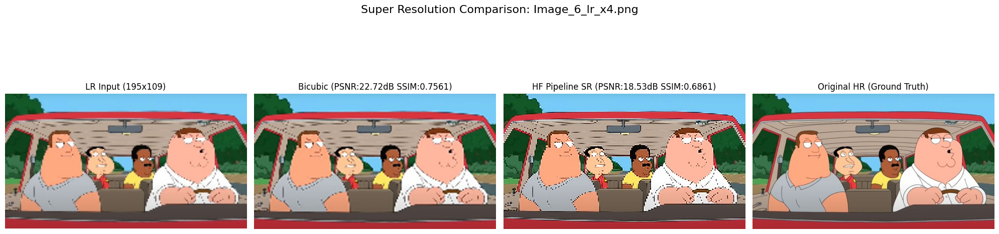


Comparing results for: Image_9_lr_x4.png
  - Bilgi: HF_SR çıktısı (448x800) HR hedefi (438x780) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (438, 780, 3), Bicubic: (438, 780, 3), HF_SR: (438, 780, 3)
  - Bicubic: PSNR=27.84 dB, SSIM=0.8977
  - HF SR  : PSNR=21.31 dB, SSIM=0.8050


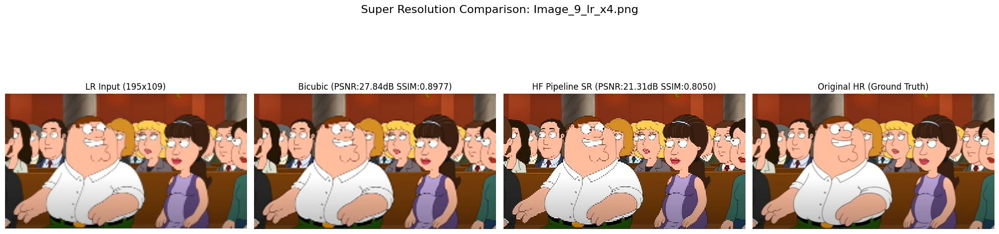


Comparing results for: Image_29_lr_x4.png
  - Bilgi: HF_SR çıktısı (448x800) HR hedefi (438x780) ile eşleşmesi için kırpılıyor.
  - Shapes after potential crop -- HR: (438, 780, 3), Bicubic: (438, 780, 3), HF_SR: (438, 780, 3)
  - Bicubic: PSNR=26.16 dB, SSIM=0.8304
  - HF SR  : PSNR=20.93 dB, SSIM=0.7294


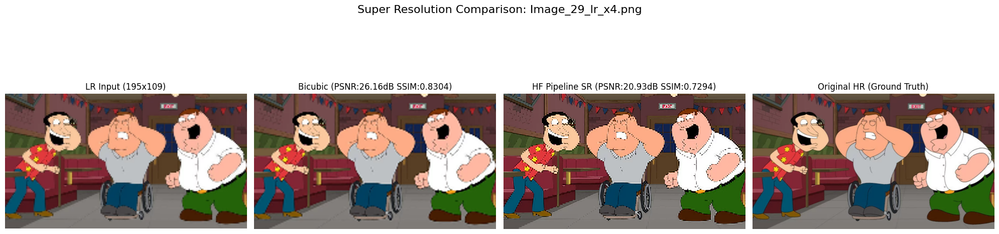


--- Finished Comparison for 31 images ---

--- Average Metrics ---
Bicubic    : Avg PSNR = 27.71 dB, Avg SSIM = 0.8964
HF Pipeline: Avg PSNR = 23.48 dB, Avg SSIM = 0.8521
-------------------------
Improvement: Avg PSNR = +-4.23 dB, Avg SSIM = +-0.0443
(Higher is better for both PSNR and SSIM)


In [5]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

try:
    from skimage.metrics import peak_signal_noise_ratio as psnr
    from skimage.metrics import structural_similarity as ssim
except ImportError:
    print("ERROR: scikit-image metrics could not be imported. Please run Step B.1 again.")
    metrics_available = False
else:
    metrics_available = True

results_list = []

if 'test_images_sr' not in locals() or not test_images_sr:
    print("ERROR: test_images_sr list not found or is empty. Please run previous steps.")
else:
    print("\n--- Comparing SR Results ---")
    num_processed = 0
    for i, pair in enumerate(test_images_sr):
        lr_path = pair.get('lr')
        hr_path = pair.get('hr')
        bicubic_path = pair.get('bicubic')
        hf_sr_path = pair.get('hf_sr') 
        if not all([lr_path, hr_path, bicubic_path, hf_sr_path]):
            print(f"\nSkipping index {i}: Missing one or more result paths.")
            continue

        base_filename = os.path.basename(lr_path)
        print(f"\nComparing results for: {base_filename}")

        try:
            img_lr = cv2.imread(lr_path)
            img_hr = cv2.imread(hr_path)
            img_bicubic = cv2.imread(bicubic_path)
            img_hf_sr = cv2.imread(hf_sr_path) 

            if img_lr is None or img_hr is None or img_bicubic is None or img_hf_sr is None:
                print("  - Error loading one or more images for comparison. Skipping.")
                continue

            target_height, target_width = img_hr.shape[:2]

            current_hf_height, current_hf_width = img_hf_sr.shape[:2]
            if current_hf_height > target_height or current_hf_width > target_width:
                print(f"  - Bilgi: HF_SR çıktısı ({current_hf_height}x{current_hf_width}) HR hedefi ({target_height}x{target_width}) ile eşleşmesi için kırpılıyor.")
                img_hf_sr = img_hf_sr[0:target_height, 0:target_width, :]

            print(f"  - Shapes after potential crop -- HR: {img_hr.shape}, Bicubic: {img_bicubic.shape}, HF_SR: {img_hf_sr.shape}")

            shape_match = (img_hr.shape == img_bicubic.shape == img_hf_sr.shape)
            if not shape_match:
                print(f"  - UYARI: Boyutlar kırpmadan sonra bile eşleşmiyor! Metrikler atlanıyor.")
                psnr_b, ssim_b, psnr_hf, ssim_hf = None, None, None, None
            elif not metrics_available:
                 print("  - Skipping metrics calculation because scikit-image is not available.")
                 psnr_b, ssim_b, psnr_hf, ssim_hf = None, None, None, None
            else:
                try:
                    psnr_b = psnr(img_hr, img_bicubic, data_range=255)
                    ssim_b = ssim(img_hr, img_bicubic, channel_axis=-1, data_range=255) 
                except ValueError as e: 
                     print(f"  - Could not calculate metrics for Bicubic: {e}")
                     psnr_b, ssim_b = None, None

                try:
                    psnr_hf = psnr(img_hr, img_hf_sr, data_range=255)
                    ssim_hf = ssim(img_hr, img_hf_sr, channel_axis=-1, data_range=255)
                except ValueError as e:
                     print(f"  - Could not calculate metrics for HF Pipeline SR: {e}")
                     psnr_hf, ssim_hf = None, None

                print(f"  - Bicubic: PSNR={psnr_b:.2f} dB, SSIM={ssim_b:.4f}" if psnr_b is not None else "  - Bicubic: Metrics N/A")
                print(f"  - HF SR  : PSNR={psnr_hf:.2f} dB, SSIM={ssim_hf:.4f}" if psnr_hf is not None else "  - HF SR  : Metrics N/A")

                results_list.append({
                    'filename': base_filename,
                    'psnr_bicubic': psnr_b, 'ssim_bicubic': ssim_b,
                    'psnr_hf_sr': psnr_hf, 'ssim_hf_sr': ssim_hf
                })

            plt.figure(figsize=(20, 6)) 

            plt.subplot(1, 4, 1)
            plt.imshow(cv2.cvtColor(img_lr, cv2.COLOR_BGR2RGB))
            plt.title(f'LR Input ({img_lr.shape[1]}x{img_lr.shape[0]})')
            plt.axis('off')

            plt.subplot(1, 4, 2)
            plt.imshow(cv2.cvtColor(img_bicubic, cv2.COLOR_BGR2RGB))
            psnr_title_b = f"{psnr_b:.2f}dB" if psnr_b is not None else "N/A"
            ssim_title_b = f"{ssim_b:.4f}" if ssim_b is not None else "N/A"
            plt.title(f'Bicubic (PSNR:{psnr_title_b} SSIM:{ssim_title_b})')
            plt.axis('off')

            plt.subplot(1, 4, 3)
            plt.imshow(cv2.cvtColor(img_hf_sr, cv2.COLOR_BGR2RGB))
            psnr_title_hf = f"{psnr_hf:.2f}dB" if psnr_hf is not None else "N/A"
            ssim_title_hf = f"{ssim_hf:.4f}" if ssim_hf is not None else "N/A"
            plt.title(f'HF Pipeline SR (PSNR:{psnr_title_hf} SSIM:{ssim_title_hf})')
            plt.axis('off')

            plt.subplot(1, 4, 4)
            plt.imshow(cv2.cvtColor(img_hr, cv2.COLOR_BGR2RGB))
            plt.title(f'Original HR (Ground Truth)')
            plt.axis('off')

            plt.suptitle(f'Super Resolution Comparison: {base_filename}', fontsize=16)
            plt.tight_layout(rect=[0, 0.03, 1, 0.95])
            plt.show()

            num_processed += 1

        except Exception as e:
            print(f"  - An unexpected error occurred comparing {base_filename}: {e}")

    print(f"\n--- Finished Comparison for {num_processed} images ---")

    if results_list:
        avg_psnr_b = np.nanmean([r['psnr_bicubic'] for r in results_list if r['psnr_bicubic'] is not None])
        avg_ssim_b = np.nanmean([r['ssim_bicubic'] for r in results_list if r['ssim_bicubic'] is not None])
        avg_psnr_hf = np.nanmean([r['psnr_hf_sr'] for r in results_list if r['psnr_hf_sr'] is not None])
        avg_ssim_hf = np.nanmean([r['ssim_hf_sr'] for r in results_list if r['ssim_hf_sr'] is not None])

        print("\n--- Average Metrics ---")
        print(f"Bicubic    : Avg PSNR = {avg_psnr_b:.2f} dB, Avg SSIM = {avg_ssim_b:.4f}")
        print(f"HF Pipeline: Avg PSNR = {avg_psnr_hf:.2f} dB, Avg SSIM = {avg_ssim_hf:.4f}")
        print("-" * 25)
        print(f"Improvement: Avg PSNR = +{avg_psnr_hf - avg_psnr_b:.2f} dB, Avg SSIM = +{avg_ssim_hf - avg_ssim_b:.4f}")
        print("(Higher is better for both PSNR and SSIM)")